In [1]:
# Will reload modeules after this when they change!
%load_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
import numpy as np
import os
from IPython.display import Image

# Standard plotly imports
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode

# Using plotly + cufflinks in offline mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

# Seaborn
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Matplotlib
import matplotlib.pyplot as plt
from matplotlib_venn import venn3

# Surpress umap errors
import warnings
from exploratory_data_analysis_II import *

def action_with_warnings():
    warnings.warn("should not appear")

### This script 
This script takes the dataframes for experimental samples, searched database, and chemical features/descriptors for processing prior to exploratory data analysis.

### Observations:
1. 

# Loads pickles from:
http://localhost:8888/notebooks/PycharmProjects/neutral_loss/nl_0_3_clean_join_nb.ipynb

In [4]:
data_df = pd.read_pickle('high_quality.pickle')
db_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/core_metabolome_out.pickle') 
mord_norm_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/mord_norm_df.pickle') 
morg_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/bits_df.pickle')

In [5]:
# Useful way to split data:
data_df['fourX'] = data_df['analyzer'] + '_' + data_df['polarity']

# Annotate classes of observations:
data_df = annotate_nl(data_df, 'H2O')

In [6]:
df = data_df[['formula','n_loss_only_H2O', 'n_loss_wparent_H2O',
             'n_loss_none_H2O']].astype(bool).sum()
df

formula               196569
n_loss_only_H2O        52845
n_loss_wparent_H2O     31003
n_loss_none_H2O       112721
dtype: int64

In [7]:
df = data_df[['formula','n_loss_only_H2O', 'n_loss_wparent_H2O',
             'n_loss_none_H2O']]
df = df.groupby(['n_loss_only_H2O', 'n_loss_wparent_H2O',
             'n_loss_none_H2O']).nunique().iloc[:,0:1]
df

formula
n_loss_only_H2O n_loss_wparent_H2O n_loss_none_H2O         
False           False              True                3049
                True               False               2144
True            False              False               2681

Venn diagram for observed losses out of 3116 unique formulas


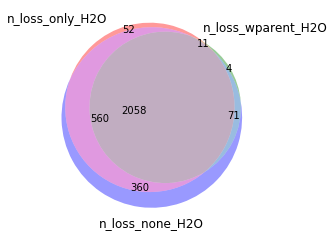

In [8]:
venn_3_f_df(data_df, 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O', 'formula')

In [9]:
data_df.to_pickle('high_quality.pickle')

In [16]:
### Generate observed dataframe
# Three histograms by formula:
obs_df = generate_obs_df(data_df, 'ds_id')

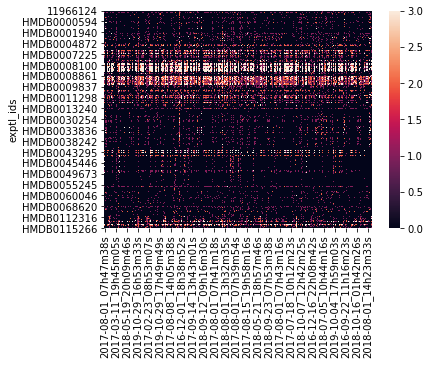

In [23]:
ax = sns.heatmap(obs_df)

Text(0.5, 0.98, 'Clustermap of core metabolome (y) ids by dataset (x)')

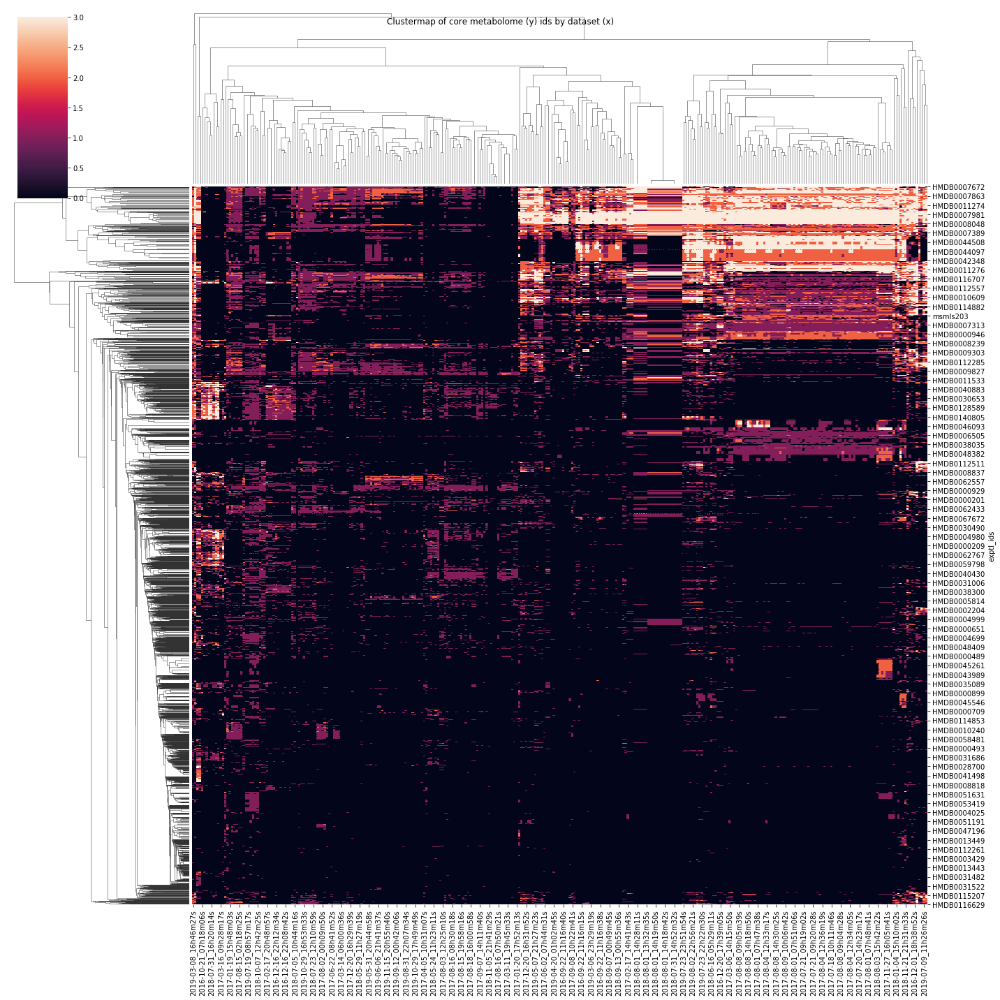

In [31]:
fg = sns.clustermap(obs_df, figsize=(20, 20))
fg.fig.suptitle('Clustermap of core metabolome (y) ids by dataset (x)')

In [33]:
obs_df.to_pickle('obs_df')

Text(0.5, 0.98, 'Clustermap of core metabolome (y) ids by group (x)')

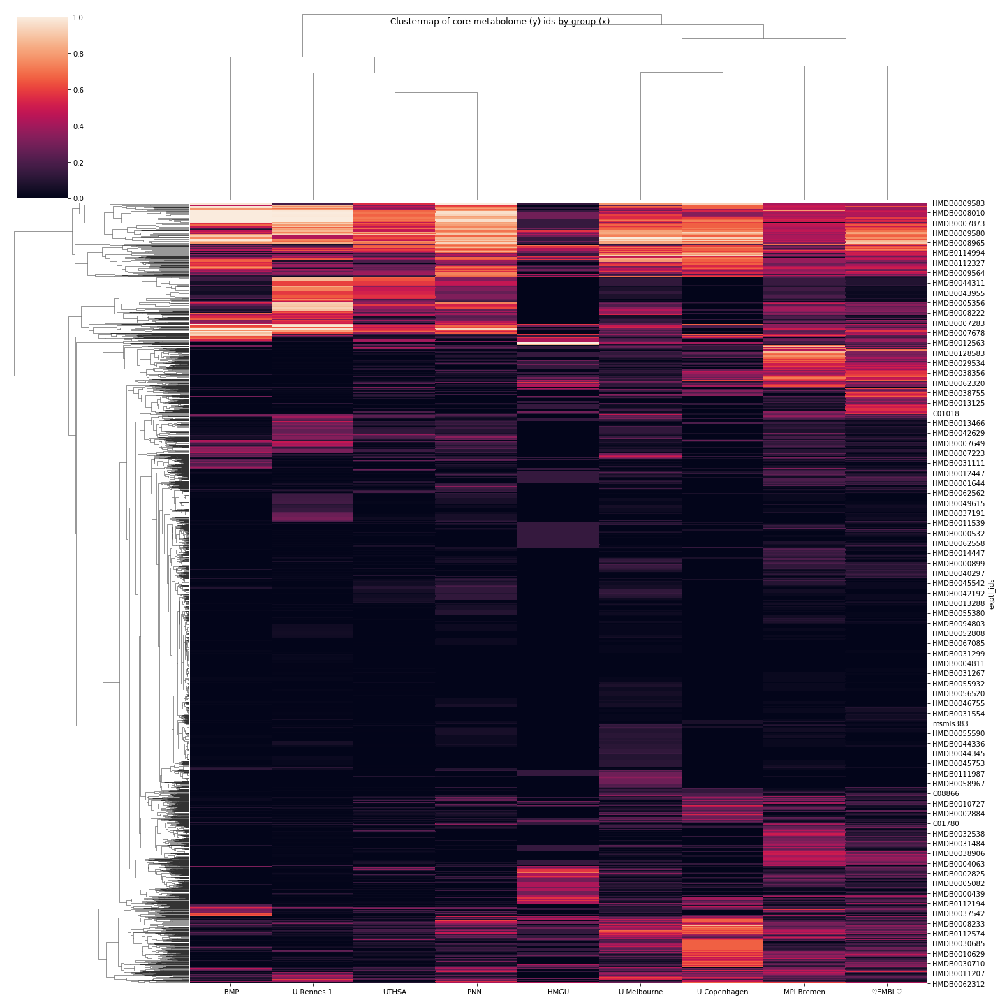

In [49]:
group_df = generate_obs_df(data_df, 'group')
# group_df = normalize_df(group_df) # after next reload
group_df = (group_df - group_df.min()) / (group_df.max() - group_df.min())

fg = sns.clustermap(group_df, figsize=(20, 20))
fg.fig.suptitle('Clustermap of core metabolome (y) ids by group (x)')

Text(0.5, 0.98, 'Clustermap of core metabolome (y) ids by inst/pol (x)')

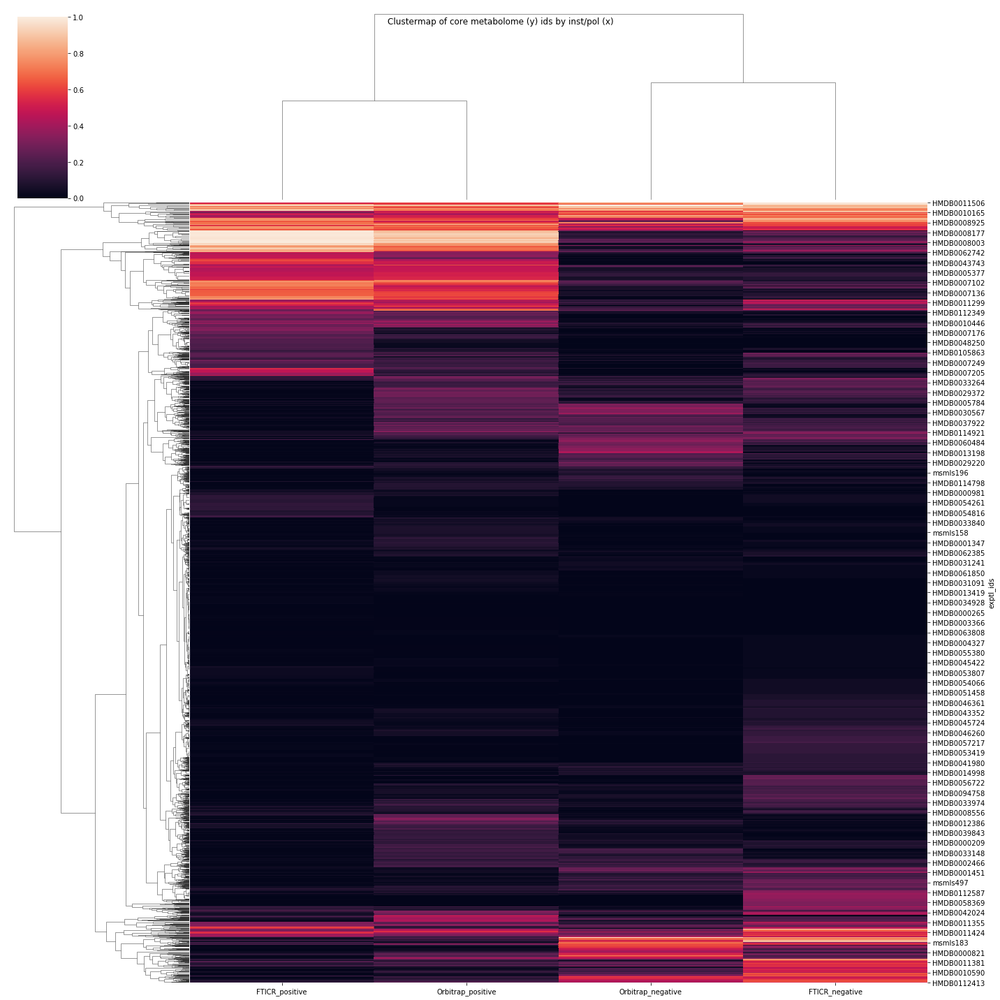

In [51]:
df = generate_obs_df(data_df, 'fourX')
# group_df = normalize_df(group_df) # after next reload
fourX_df = (df - df.min()) / (df.max() - df.min())

fg = sns.clustermap(fourX_df, figsize=(20, 20))
fg.fig.suptitle('Clustermap of core metabolome (y) ids by inst/pol (x)')

In [52]:
data_df['group_4x'] = data_df['group_4x'] + '_' + data_df['fourX']

Text(0.5, 0.98, 'Clustermap of core metabolome (y) ids by group/inst/pol (x)')

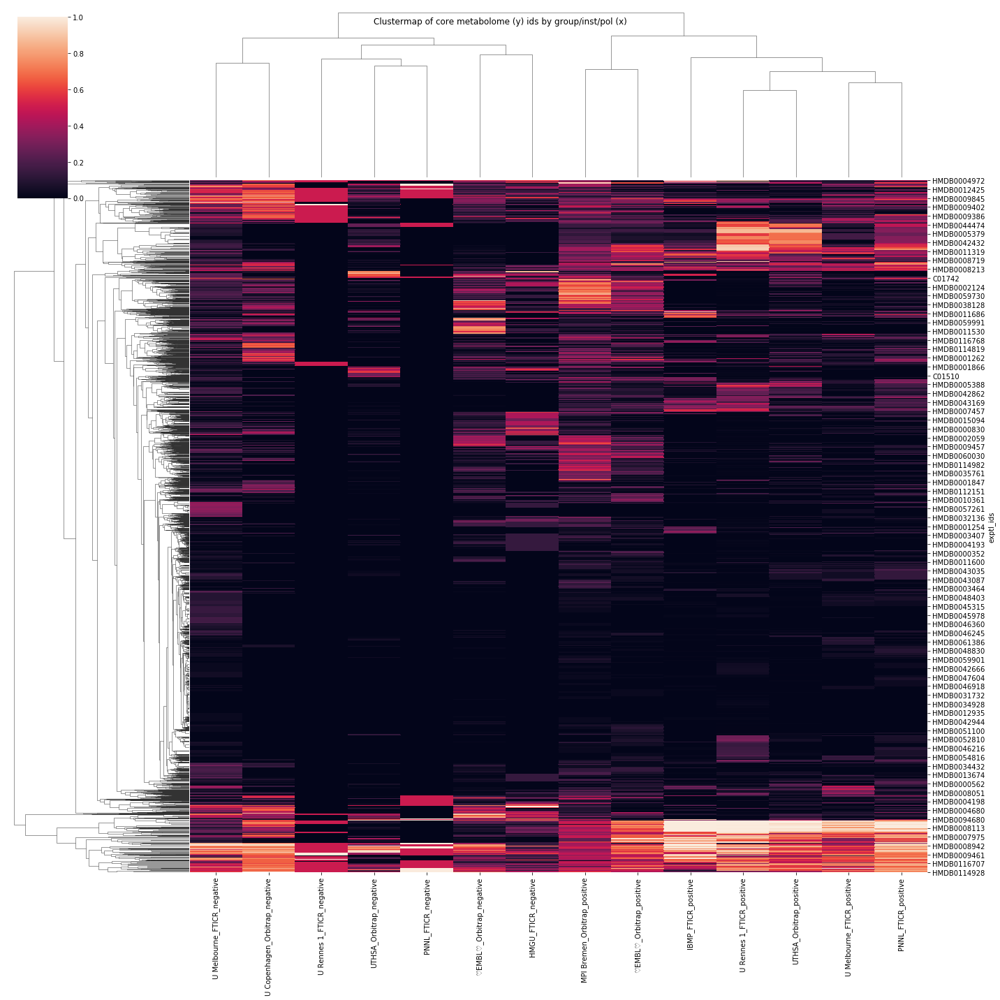

In [54]:
df = generate_obs_df(data_df, 'group_4x')
# group_df = normalize_df(group_df) # after next reload
group_4x_df = (df - df.min()) / (df.max() - df.min())

fg = sns.clustermap(group_4x_df, figsize=(20, 20))
fg.fig.suptitle('Clustermap of core metabolome (y) ids by group/inst/pol (x)')

In [55]:
# Negative and positve cluster differently, FT and Orbi not so much.
# Should be able to treat as two cases.  Expected result.

In [56]:
# Multiple histogram example
cols = ['formula', 'ds_id']
df = data_df[cols]
fig = df.iplot(kind='histogram', subplots=True, shape=(1,2))

In [57]:
# Multiple histogram example
cols = ['analyzer', 'polarity', 'group']
df = data_df[cols]
fig = df.iplot(kind='histogram', subplots=True, shape=(3,1))

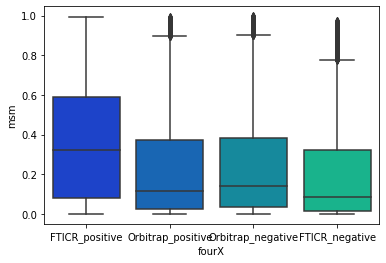

In [59]:
# Groupby boxplot
# Much quicker!
df = data_df[['fourX', 'msm']]
sns.boxplot(x='fourX', y='msm', data=df, palette='winter')

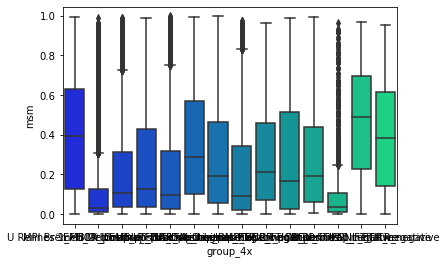

In [58]:
# Groupby boxplot
# Much quicker!
df = data_df[['group_4x', 'msm']]
sns.boxplot(x='group_4x', y='msm', data=df, palette='winter')

In [78]:
# No FDR filtering!
df = data_df[['group_4x', 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O']]
df = df.groupby(['group_4x']).sum()
#df = df.unstack().fillna(0)
df

,n_loss_only_H2O,n_loss_wparent_H2O,n_loss_none_H2O
group_4x,,,
HMGU_FTICR_negative,610.0,360.0,1321.0
IBMP_FTICR_positive,4737.0,2555.0,10579.0
MPI Bremen_Orbitrap_positive,5467.0,5602.0,8664.0
PNNL_FTICR_negative,68.0,41.0,120.0
PNNL_FTICR_positive,2555.0,1462.0,5397.0
U Copenhagen_Orbitrap_negative,1105.0,1554.0,3810.0
U Melbourne_FTICR_negative,3610.0,2611.0,7548.0
U Melbourne_FTICR_positive,935.0,658.0,3101.0
U Rennes 1_FTICR_negative,73.0,27.0,156.0


In [79]:
df.iplot(kind='bar')

In [84]:
df = df.apply(lambda x: x/x.max(), axis=1)

In [85]:
df.iplot(kind='bar')

In [ ]:
### Place in final plotting notebook!
# FDR filtering to 20%: 
data_df = data_df[~data_df.fdr.isin([0.5])]
data_df.fdr.unique()